In [1]:
import requests
import json
import pandas as pd
import geopandas as gpd

import numpy as np

In [2]:
import os
import sys

In [3]:
import contextily as cx

In [4]:
%matplotlib inline

In [5]:
import matplotlib.pyplot as plt

In [6]:
bbox_shapely = [
    [-122.4240775827961, 37.795],
    [-122.4240775827961, 37.810],
    [-122.41, 37.810],
    [-122.41, 37.795],
]

In [7]:
from shapely import geometry
from shapely.geometry import box

poly = geometry.Polygon(bbox_shapely)

In [8]:
footprints = gpd.read_file("/home/thomas/Work/Research/uil/macro_energy/data/san-fransisco/prepped/footprints.geojson")

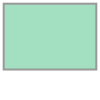

In [9]:
box(*footprints.geometry.unary_union.bounds)

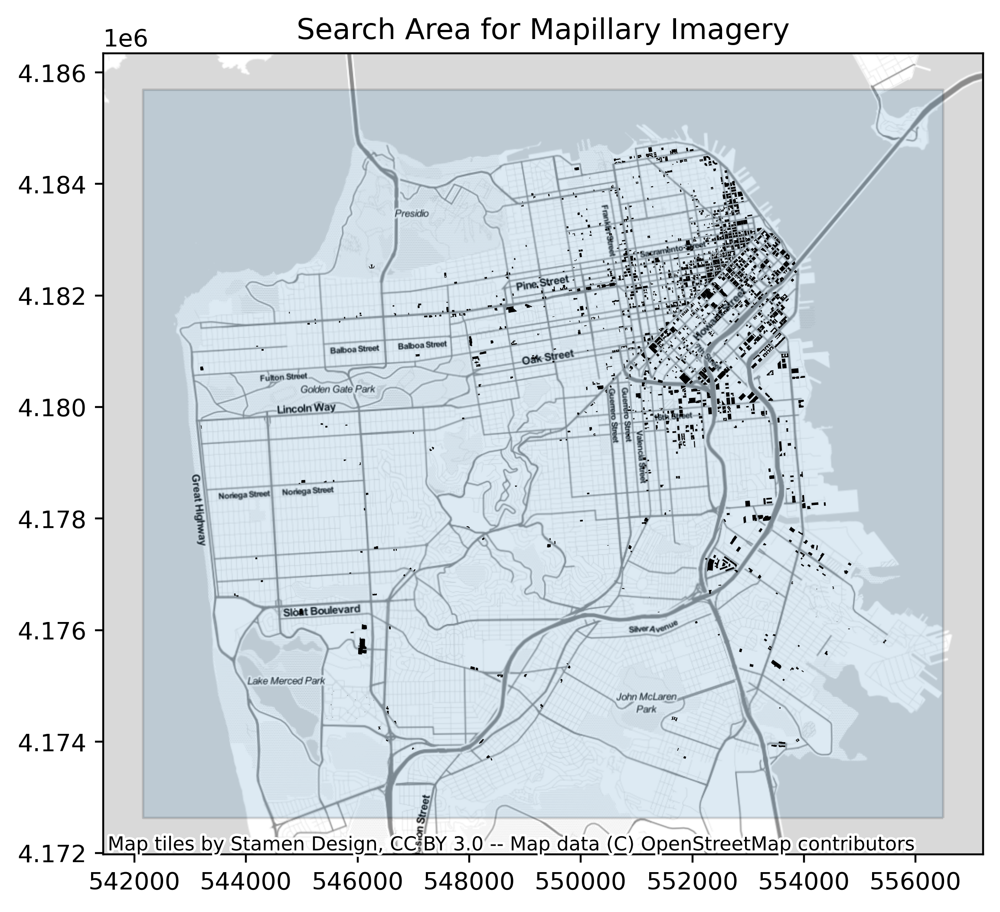

In [10]:
extra_perimeter = 1000

fig, ax = plt.subplots(figsize=(10,6), dpi=400)

poly = box(*footprints.geometry.unary_union.bounds)
bounding_gdf = gpd.GeoDataFrame(geometry = [poly], crs=4326).to_crs(32610).buffer(extra_perimeter)
# now I want to sharpen the edges

box_dimensions = bounding_gdf.bounds.iloc[0]
sharp_bounds = box(*box_dimensions)
bounding_gdf = gpd.GeoDataFrame(geometry = [sharp_bounds], crs=32610)

bounding_gdf.plot(
    ax = ax,
    alpha=0.15,
#     fillcolor=None,
    edgecolor='black',
)

footprints.to_crs(32610).plot(
    ax=ax,
    color="black"
)

cx.add_basemap(ax, crs= bounding_gdf.crs)

plt.title("Search Area for Mapillary Imagery")
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= bounding_gdf.crs)
# cx.add_basemap(ax, source=cx.providers.Stamen.TonerLabels)

In [11]:
footprints.geometry.unary_union.bounds

(-122.50970893099998, 37.708900632, -122.37040971300002, 37.80790894900002)

In [12]:
import math
math.pow(1000, 0.5)

31.622776601683793

In [17]:
# # want the cells to roughly be 2500m2
# cell_size = math.pow(0.5e6, 0.5)

# x_splits = np.arange(box_dimensions.minx, box_dimensions.maxx, cell_size)
# y_splits = np.arange(box_dimensions.miny, box_dimensions.maxy, cell_size)

# X = np.stack([
#     x_splits[:-1], 
#     x_splits[1:], 
# ]).T

# Y = np.stack([
#     y_splits[:-1], 
#     y_splits[1:], 
# ]).T
# # cell_boundaries = np.stack([
# #     x_splits[:-1], 
# #     y_splits[:-1],
# #     x_splits[1:], 
# #     y_splits[1:], 
# # ]).T

# cell_list = []
# for x in X:
#     for y in Y:
# #         print(x)
#         cell_list.append(box(x[0], y[0], x[1], y[1]))

# # cell_list = []
# # for cell_boundary in cell_boundaries:
# #     cell_list.append(box(*cell_boundary))

In [50]:
cells_gdf = gpd.GeoDataFrame(geometry = cell_list, crs=32610)

NameError: name 'cell_list' is not defined

In [19]:
# from matplotlib_scalebar.scalebar import ScaleBar

# fig, ax = plt.subplots(figsize=(10,10), dpi=500)
# plt.locator_params(axis='x', nbins=7)

# cells_gdf.plot(
#     ax = ax,
#     alpha=0.1,
# #     fillcolor=None,
#     edgecolor='black',
# )

# footprints.to_crs(32610).plot(
#     ax=ax,
#     color="black"
# )

# ax.add_artist(ScaleBar(1))

# cx.add_basemap(ax, crs= cells_gdf.crs)
# cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= cells_gdf.crs)

# plt.title("Search Area for Panoramic Imagery - SF")
# plt.savefig("sf-boxregions.png")

# plt.show()

In [22]:
# cell_querystring = []

# for cell in cells_gdf.to_crs(4326).geometry:
#     cell_querystring.append(''.join(str(cell.bounds).strip('()').split(' ')))

In [23]:
city_path = "/home/thomas/Work/Research/uil/dbr/data/san-fransisco"

In [24]:
destination_dir = os.path.join(city_path, "panoimages/raw")

In [25]:
destination_testdir = os.path.join(city_path, "panoimages/testdir")

In [26]:
bbox = [
    -122.4240775827961,
    37.795,
    -122.41,
    37.810
]

In [27]:
bstring = (',').join([ str(x) for x in bbox ])

In [31]:
# bstring = cell_querystring[268]
# bstring

In [33]:
import shapely

In [34]:
from tqdm import tqdm

In [35]:
# metadata = []

# for cellquery in tqdm(cell_querystring):
#     url = "https://graph.mapillary.com/images?access_token={}&bbox={}&fields=id,captured_at,thumb_original_url,compass_angle,exif_orientation,geometry,camera_type".format(
#         access_token, 
#         cellquery
#     )

#     payload={}
#     headers = {}

#     response = requests.request("GET", url, headers=headers, data=payload).json()

#     if 'data' in response:
#         data_response = response['data']
#         geodata = gpd.GeoDataFrame(data_response)
#         if len(geodata) > 0:
#             geodata.geometry = geodata.geometry.apply(lambda x: shapely.Point(x['coordinates']))
#             geodata_fisheye = geodata.loc[geodata.camera_type.isin(["spherical","equirectangular"])]
#             image_metadata = geodata_fisheye#.drop(columns=["computed_geometry","computed_rotation","mesh"])
#             if len(image_metadata) > 0:
#                 metadata.append(image_metadata)
# #     else:
# #         print(f"No data found for: {cellquery}")

In [36]:
# full_metadata = pd.concat(metadata, ignore_index=True).set_crs(4326)

In [37]:
# full_metadata = full_metadata.rename(columns={"id":"pano_id"})

In [38]:
# full_metadata.to_file(os.path.join(city_path, "pano_metadata.geojson"))

In [39]:
# full_metadata = gpd.read_file(os.path.join(city_path, "pano_metadata.geojson"))

In [40]:
# full_metadata.explore()

In [43]:
# celljoined = gpd.sjoin(cellcopy.to_crs(4326), full_metadata[["pano_id","geometry"]], predicate="contains")
# celljoined

In [44]:
# cellcounts = celljoined.groupby(by="idx").count().reset_index()[["idx","index_right"]]

In [45]:
# default = np.zeros(len(cellcopy))
# default[cellcounts['idx']] = cellcounts['index_right'] # / max(cellcounts['index_right']) )

# cellcopy['panocount'] = default
# cellcolors = [ plt.cm.viridis(x) for x in np.log(cellcounts['index_right'] / max(cellcounts['index_right'])) ]

In [46]:
# from matplotlib_scalebar.scalebar import ScaleBar
# from mpl_toolkits.axes_grid1 import make_axes_locatable

# fig, ax = plt.subplots(figsize=(10,10), dpi=500)
# plt.title("Count of Panoramic Images by Geographic Cell")

# plt.locator_params(axis='x', nbins=7)

# divider = make_axes_locatable(ax)
# cax = divider.append_axes("right", size="5%", pad=0.1)

# # full_metadata_meters = full_metadata.to_crs(32610)
# cellcopy.to_crs(32610).plot(
#     ax = ax,
#     column = 'panocount',
#     colormap = 'viridis',
#     alpha = 0.4,
#     legend=True,
#     cax=cax
# )

# ax.add_artist(ScaleBar(1))

# cx.add_basemap(ax, crs= cellcopy.to_crs(32610).crs)
# cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= cellcopy.to_crs(32610).crs)

# plt.savefig("sf-panos.png")
# plt.show()

In [47]:
import torch
# results_dir = os.path.join('results','e5')
# os.makedirs(results_dir, exist_ok=True)

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

config = {
    "custom_optimizer": torch.optim.Adam,
    "lr" : 0.01,
    'epochs': 3000,
    'linear_layers': 2,
    'hidden_channels': 8,
    'dropout': 0.5,
    'test-percent': 30,
    'building_buffer': 300,
    'neighbor_radius': 100,
    'n_cv': 3,
    'cv_size': 600
}

In [48]:
from src.graph_construction import graph
g1, g1a = graph(
    "new-york",
    neighbor_radius=150,
    building_buffer=config['building_buffer'],
    test_percent=config['test-percent']
)

g2, g2a = graph(
    "san-francisco",
    neighbor_radius=150,
    building_buffer=config['building_buffer'],
    test_percent=config['test-percent']
)

g3, g3a = graph(
    "austin",
    neighbor_radius=150,
    building_buffer=config['building_buffer'],
    test_percent=config['test-percent']
)

# g1p = pool_adjacency(g1, g1a)

In [64]:
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10,10), dpi=1000)
plt.locator_params(axis='x', nbins=7)

g3a['footprints'].to_crs(32614).plot(
    ax=ax,
    color="black"
)

g3a['node_data_original'].to_crs(32614).plot(
    ax=ax,
    color="orange",
    markersize=0.5,
    alpha=1.0
)

ax.add_artist(ScaleBar(1))

cx.add_basemap(ax, crs= 32614)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= 32614)

building_patch = mpatches.Patch(color='black', label="Reported Building")
pano_patch = mpatches.Patch(color="orange", label="Panoramic Photo")

plt.legend(handles=[building_patch, pano_patch], loc="upper left")

plt.title("Panoramic Imagery - Austin")
plt.savefig("austin-panoramas.png")

plt.show()

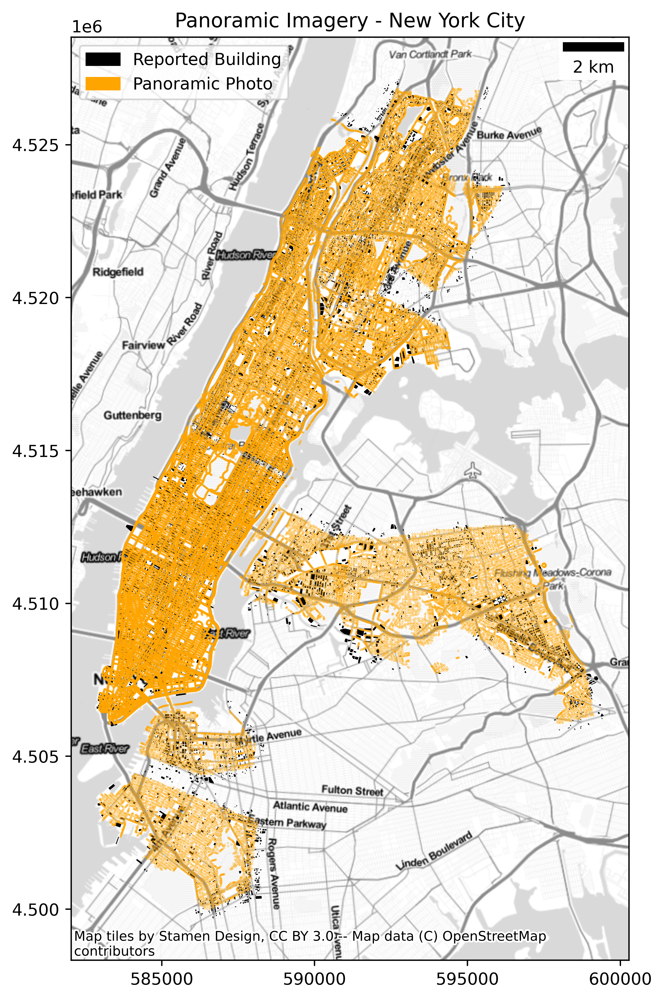

In [65]:
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10,10), dpi=500)
plt.locator_params(axis='x', nbins=7)

g1a['footprints'].to_crs(32618).plot(
    ax=ax,
    color="black"
)

g1a['node_data_original'].to_crs(32618).plot(
    ax=ax,
    color="orange",
    markersize=0.03,
    alpha=0.9
)

ax.add_artist(ScaleBar(1))

cx.add_basemap(ax, crs= 32618)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= 32618)

building_patch = mpatches.Patch(color='black', label="Reported Building")
pano_patch = mpatches.Patch(color="orange", label="Panoramic Photo")

plt.legend(handles=[building_patch, pano_patch], loc="upper left")

plt.title("Panoramic Imagery - New York City")
plt.savefig("nyc-panoramas.png")

plt.show()

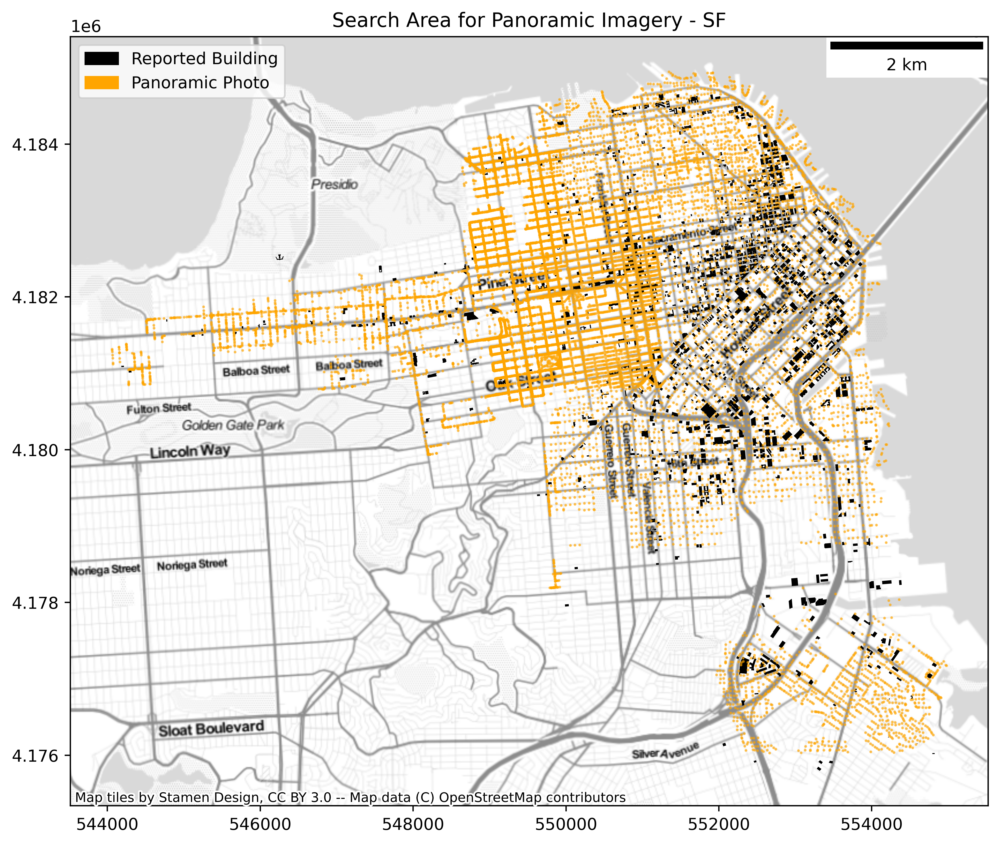

In [52]:
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10,10), dpi=500)
plt.locator_params(axis='x', nbins=7)

g2a['footprints'].to_crs(32610).plot(
    ax=ax,
    color="black"
)

g2a['node_data_original'].to_crs(32610).plot(
    ax=ax,
    color="orange",
    markersize=0.5,
    alpha=0.6
)

ax.add_artist(ScaleBar(1))

cx.add_basemap(ax, crs= 32610)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= 32610)

building_patch = mpatches.Patch(color='black', label="Reported Building")
pano_patch = mpatches.Patch(color="orange", label="Panoramic Photo")

plt.legend(handles=[building_patch, pano_patch], loc="upper left")

plt.title("Search Area for Panoramic Imagery - SF")
plt.savefig("sf-panoramas.png")

plt.show()

In [ ]:
# image_counts = [ len(x) for x in metadata ]
# image_counts_norm = [ plt.cm.jet(x / max(image_counts)) for x in image_counts ]

In [ ]:
# from matplotlib_scalebar.scalebar import ScaleBar

# fig, ax = plt.subplots(figsize=(10,10), dpi=500)
# plt.locator_params(axis='x', nbins=7)

# full_metadata_meters = full_metadata.to_crs(32610)
# full_metadata_meters.plot(
#     ax=ax,
#     color="black"
# )

# ax.add_artist(ScaleBar(1))

# cx.add_basemap(ax, crs= full_metadata_meters.crs)
# cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= full_metadata_meters.crs)

# plt.title("Panoramic Imagery - SF")
# plt.savefig("sf-panos.png")

# plt.show()

In [ ]:
# full_metadata.to_file(os.path.join(city_path, "pano_metadata.geojson"))

In [ ]:
# image_url = geodata.iloc[0].thumb_original_url
# image_url

In [ ]:
# image_metadata.iloc[0].id

In [ ]:
# os.path.isfile(im)

In [ ]:
import shutil


In [ ]:
destination_dir

In [ ]:
full_metadata[:50][full_metadata[:50].pano_id == "295155715490144"].iloc[0].thumb_original_url

In [ ]:
import os
import shutil

for index, image_metadataterm in full_metadata.iterrows():
    image_id = image_metadataterm.pano_id
    image_url = image_metadataterm.thumb_original_url
    
    image_path = os.path.join(destination_dir, image_id + ".png")
    if not os.path.isfile(image_path):
        response = requests.get(image_url, stream=True)
        with open(image_path, 'wb') as out_file:
            shutil.copyfileobj(response.raw, out_file)
    else:
        print(f"Found image: {image_id[:5]}")

In [ ]:
import geopandas as gpd
import pandas as pd

nycfootprints = gpd.read_file("/home/thomas/Work/Research/uil/dbr/data/new-york/footprints.geojson")

In [ ]:
nycenergy = pd.read_csv("/home/thomas/Work/Research/uil/dbr/data/new-york/energy.csv")

In [ ]:
nycnodes = gpd.read_file("/home/thomas/Work/Research/uil/dbr/data/new-york-raw/nodes.geojson")

In [ ]:
nycnodes.pano_date[0]

In [ ]:
nycfootprints.explore()

In [ ]:
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10,10), dpi=500)
plt.locator_params(axis='x', nbins=7)

# cells_gdf.plot(
#     ax = ax,
#     alpha=0.1,
# #     fillcolor=None,
#     edgecolor='black',
# )

nycfootprints.to_crs(32618).plot(
    ax=ax,
    color="black"
)

nycnodes.to_crs(32618).plot(
    ax=ax,
    color="orange",
    markersize=0.2,
    alpha=0.3
)

ax.add_artist(ScaleBar(1))

cx.add_basemap(ax, crs= 32618)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= 32618)

building_patch = mpatches.Patch(color='black', label="Reported Building")
pano_patch = mpatches.Patch(color="orange", label="Panoramic Photo")

plt.legend(handles=[building_patch, pano_patch], loc="upper left")

plt.title("Search Area for Panoramic Imagery - NYC")
plt.savefig("nyc-panoramas-big.png")

plt.show()

In [ ]:
from shapely.geometry import box
nycnodebox = box(*nycnodes.to_crs(32618).unary_union.bounds)

In [ ]:
nycgeobox = gpd.GeoDataFrame(geometry=[nycnodebox], crs=32618)

In [ ]:
nycboxfootprints = nycgeobox.sjoin(nycfootprints.to_crs(32618), predicate="contains").reset_index()
nycboxfootprints['id'] = nycboxfootprints.id.astype(str)

In [ ]:
nycboxfootprints['id']

In [ ]:
nycfootprints.id

In [ ]:
nyc_boxfilterfootprints = nycfootprints.merge(nycboxfootprints.drop(columns=["geometry"]), on="id", how="inner")

In [ ]:
nyc_boxfilterfootprints.total_bounds

In [ ]:
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(6,6), dpi=500)
plt.locator_params(axis='x', nbins=5)

# cells_gdf.plot(
#     ax = ax,
#     alpha=0.1,
# #     fillcolor=None,
#     edgecolor='black',
# )

nycfootprints.to_crs(32618).plot(
    ax=ax,
    color="black"
)

nycboxfootprints.to_crs(32618).geometry.boundary.plot(
    ax=ax,
    color=None,
    edgecolor='orange',
    linewidth = 2
)

ax.add_artist(ScaleBar(1))

cx.add_basemap(ax, crs= 32618)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= 32618)

building_patch = mpatches.Patch(color='black', label="Reported Building")
pano_patch = mpatches.Patch(color="orange", label="Panoramic Region")

plt.legend(handles=[building_patch, pano_patch], loc="upper left")

plt.title("Search Area for Panoramic Imagery - NYC")
plt.savefig("nyc-panoramas-big.png")

plt.show()

In [ ]:
import matplotlib.pyplot as plt
import contextily as cx

from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10,10), dpi=500)

minx, miny, maxx, maxy = nycnodes.to_crs(32618).total_bounds
ax.set_xlim(minx, maxx)
ax.set_ylim(miny, maxy)

# plt.locator_params(axis='x', nbins=7)

# cells_gdf.plot(
#     ax = ax,
#     alpha=0.1,
# #     fillcolor=None,
#     edgecolor='black',
# )

nyc_boxfilterfootprints.to_crs(32618).plot(
    ax=ax,
    color="black"
)

nycnodes.to_crs(32618).plot(
    ax=ax,
    color="orange",
    markersize=0.2,
    alpha=0.3
)

ax.add_artist(ScaleBar(1))

cx.add_basemap(ax, crs= 32618)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= 32618)

building_patch = mpatches.Patch(color='black', label="Reported Building")
pano_patch = mpatches.Patch(color="orange", label="Panoramic Photo")

plt.legend(handles=[building_patch, pano_patch], loc="upper left")

plt.title("Panoramic Coverage - Manhattan")
plt.savefig("nyc-panoramas-small.png")

plt.show()

In [ ]:
sample_im = np.random.random((100,100,3)) * 256
sample_im[-30:,:,:] = 127.

sample_im = sample_im.astype(int)

In [ ]:
plt.imshow(sample_im)

In [ ]:
sample_im.reshape((-1, 3)).sum(axis=1) == 381

In [ ]:
austin = gpd.read_file("/home/thomas/Work/Research/uil/macro_energy/data/austin/prepped/footprints.geojson")

In [ ]:
austin.explore()

In [ ]:
import json

In [ ]:
with open("/home/thomas/Downloads/.json", "r") as f:
    imjson = json.load(f)

In [ ]:
from shapely import Point

In [ ]:
Point([33.4, -100])

In [ ]:
imdf = pd.DataFrame(imjson['successResults'])


In [ ]:
imdf

In [ ]:
geomlist = [ Point([dict(x)['lng'], dict(x)['lat']]) for x in imdf.location ]

In [ ]:
austin_images = gpd.GeoDataFrame(imdf, geometry = geomlist, crs = 4326)

In [ ]:
austin_images.geometry.explore(tooltip="panoId")

In [ ]:
austin_images.date

In [ ]:
footprints = gpd.read_file("/home/thomas/Work/Research/uil/dbr/data/austin/footprints.gejson")

In [ ]:
austin_images = gpd.read_file("/home/thomas/Work/Research/uil/dbr/data/austin/nodes.geojson")

In [ ]:
import matplotlib.pyplot as plt
import contextily as cx

from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10,10), dpi=500)

proj = 32615

# minx, miny, maxx, maxy = austin_images.to_crs(32618).total_bounds
# ax.set_xlim(minx, maxx)
# ax.set_ylim(miny, maxy)

# plt.locator_params(axis='x', nbins=7)

# cells_gdf.plot(
#     ax = ax,
#     alpha=0.1,
# #     fillcolor=None,
#     edgecolor='black',
# )

footprints.to_crs(proj).plot(
    ax=ax,
    color="black"
)

austin_images.to_crs(proj).plot(
    ax=ax,
    color="orange",
    markersize=2,
    alpha=1.0
)

ax.add_artist(ScaleBar(1))

cx.add_basemap(ax, crs= proj)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLite, crs= proj)

building_patch = mpatches.Patch(color='black', label="Reported Building")
pano_patch = mpatches.Patch(color="orange", label="Panoramic Photo")

plt.legend(handles=[building_patch, pano_patch], loc="upper left")

plt.title("Panoramic Coverage - Austin TX")
plt.savefig("austin-muller.png")

plt.show()